# Imports

In [169]:
import os
from datetime import datetime, timedelta
import geopandas as gpd
import pandas as pd
import numpy as np
import geoplot as gplt
import geoplot.crs as gcrs
import matplotlib.pyplot as plt
import seaborn as sns
from shapely.geometry import Point
import mapclassify as mc
import fiona
import cartopy.crs as ccrs
%matplotlib inline
# sns.set_context('talk')

pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 1000)

In [170]:
df = pd.read_csv('unmelted_timeseries_lat_long.csv', index_col = 0)

df = df[['Province/State', 'country', 'Lat', 'Long', 'latest_hosp_beds_per_1000', 'latest_doctors_per_1000', 'GDP_per_capita', 
                     'SPAR_index', 'IVDI_score', 'city_pop', 'effective_dist', 'geo_dist', 'ann_pass_flux', 
                     'connected_airports', '12/08/19', '12/09/19', '12/10/19', '12/11/19', '12/12/19', 
                        '12/13/19', '12/14/19', '12/15/19', '12/16/19', '12/17/19', '12/18/19', '12/19/19', 
                        '12/20/19', '12/21/19', '12/22/19', '12/23/19', '12/24/19', '12/25/19', '12/26/19', 
                        '12/27/19', '12/28/19', '12/29/19', '12/30/19', '12/31/19', '01/01/20', '01/02/20', 
                        '01/03/20', '01/04/20', '01/05/20', '01/06/20', '01/07/20', '01/08/20', '01/09/20',
                       '1/10/20', '01/11/20', '01/12/20', '01/13/20', '01/14/20', '01/15/20', '01/16/20', 
                        '01/17/20', '01/18/20', '01/19/20', '01/20/20', '01/21/20', '1/22/20', '1/23/20', 
                        '1/24/20', '1/25/20', '1/26/20', '1/27/20', '1/28/20', '1/29/20', '1/30/20', '1/31/20',
                       '2/1/20', '2/2/20', '2/3/20', '2/4/20', '2/5/20', '2/6/20', '2/7/20', '2/8/20', '2/9/20',
                       '2/10/20', '2/11/20', '2/12/20', '2/13/20', '2/14/20', '2/15/20', '2/16/20', '2/17/20', 
                        '2/18/20', '2/19/20', '2/20/20', '2/21/20', '2/22/20', '2/23/20', '2/24/20', '2/25/20', 
                        '2/26/20', '2/27/20', '2/28/20', '2/29/20', '3/1/20', '3/2/20', '3/3/20',
       '3/4/20']]

df_geometry = [Point(xy) for xy in zip(df.Long, df.Lat)]

# Coordinate reference system : WGS84
crs = {'init': 'epsg:4326'}

# Creating a Geographic data frame 
df_g = gpd.GeoDataFrame(df, crs=crs, geometry=df_geometry)

df_g.head()

,Province/State,country,Lat,Long,latest_hosp_beds_per_1000,latest_doctors_per_1000,GDP_per_capita,SPAR_index,IVDI_score,city_pop,effective_dist,geo_dist,ann_pass_flux,connected_airports,12/08/19,12/09/19,12/10/19,12/11/19,12/12/19,12/13/19,12/14/19,12/15/19,12/16/19,12/17/19,12/18/19,12/19/19,12/20/19,12/21/19,12/22/19,12/23/19,12/24/19,12/25/19,12/26/19,12/27/19,12/28/19,12/29/19,12/30/19,12/31/19,01/01/20,01/02/20,01/03/20,01/04/20,01/05/20,01/06/20,01/07/20,01/08/20,01/09/20,1/10/20,01/11/20,01/12/20,01/13/20,01/14/20,01/15/20,01/16/20,01/17/20,01/18/20,01/19/20,01/20/20,01/21/20,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,2/25/20,2/26/20,2/27/20,2/28/20,2/29/20,3/1/20,3/2/20,3/3/20,3/4/20,geometry
0,"Montreal, QC",Canada,45.5017,-73.5673,2.7,2.6102,48130.255973,99.461538,0.889388,1995.696833,13.935703,11728.445145,3.350359e+06,31.884615,0.0,0,0,0.0,0.0,0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,0,0,0,0,0,0,0.0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,POINT (-73.56730000000002 45.50170000000002)
1,"Norfolk County, MA",United States,42.1767,-71.1449,2.9,2.5948,62794.585652,91.000000,0.819745,2084.068239,14.142468,11897.471941,7.638052e+06,53.764706,0.0,0,0,0.0,0.0,0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,0,0,0,0,0,0,0.0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,POINT (-71.14490000000001 42.17669999999999)
2,0,Afghanistan,33.0000,65.0000,0.5,0.2840,1955.006208,34.000000,0.257002,1504.489950,11.685906,4518.857542,6.363890e+05,11.500000,0.0,0,0,0.0,0.0,0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,0,0,0,0,0,0,0.0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,POINT (65 33)
3,0,Andorra,42.5063,1.5218,2.5,3.3333,13536.794829,36.692308,0.679377,1263.129719,13.056520,9331.330123,4.389789e+06,59.956522,0.0,0,0,0.0,0.0,0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,0,0,0,0,0,0,0.0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,POINT (1.5218 42.5063)
4,0,Argentina,-38.4161,-63.6167,5.0,3.9600,20610.568550,64.384615,0.670945,533.149167,17.576555,19082.183445,3.078085e+05,3.000000,0.0,0,0,0.0,0.0,0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,0,0,0,0,0,0,0.0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,POINT (-63.6167 -38.4161)


In [171]:
colors = {'Low passenger flux': '#02b3e4',
          'Average passenger flux': '#f95c3c' ,
          'High passenger flux': '#ff5483'}

df_g['flux_cat'] = pd.qcut(x = ts['ann_pass_flux'], q = 3, labels = ['Low passenger flux',
                                                 'Average passenger flux',
                                                 'High passenger flux'])

In [182]:
df_g['flux_cat'].head()

0    Average passenger flux
1       High passenger flux
2       High passenger flux
3        Low passenger flux
4       High passenger flux
Name: flux_cat, dtype: category
Categories (3, object): [Low passenger flux < Average passenger flux < High passenger flux]

In [172]:
# Country-level geometries, GDP, and population estimates
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))

world.head()

,pop_est,continent,name,iso_a3,gdp_md_est,geometry
0,28400000.0,Asia,Afghanistan,AFG,22270.0,"POLYGON ((61.21081709172574 35.65007233330923,..."
1,12799293.0,Africa,Angola,AGO,110300.0,(POLYGON ((16.32652835456705 -5.87747039146621...
2,3639453.0,Europe,Albania,ALB,21810.0,"POLYGON ((20.59024743010491 41.85540416113361,..."
3,4798491.0,Asia,United Arab Emirates,ARE,184300.0,"POLYGON ((51.57951867046327 24.24549713795111,..."
4,40913584.0,South America,Argentina,ARG,573900.0,(POLYGON ((-65.50000000000003 -55.199999999999...


In [173]:
# Administrative/county-level geometries for China

china = gpd.read_file('CHN_adm 2/CHN_adm3.shp') # source = https://www.diva-gis.org/
print(len(china))
china.head()

2409


,ID_0,ISO,NAME_0,ID_1,NAME_1,ID_2,NAME_2,ID_3,NAME_3,TYPE_3,ENGTYPE_3,NL_NAME_3,VARNAME_3,geometry
0,49,CHN,China,1,Anhui,1,Anqing,1,Anqing,XiÃ njÃ­shÃ¬,County City,None,None,"POLYGON ((117.2092132568359 30.62801933288586,..."
1,49,CHN,China,1,Anhui,1,Anqing,2,Huaining,XiÃ n,County,æå®å¿,HuÃ¡inÃ­ng,"POLYGON ((116.4877090454103 30.38062858581554,..."
2,49,CHN,China,1,Anhui,1,Anqing,3,Qianshan,XiÃ n,County,æ½å±±å¿,QiÃ¡nshÄn,"POLYGON ((116.4716567993166 30.4566154479981, ..."
3,49,CHN,China,1,Anhui,1,Anqing,4,Susong,XiÃ n,County,å®¿æ¾å¿,SÃ¹sÅng,"POLYGON ((116.5814666748047 30.04758644104004,..."
4,49,CHN,China,1,Anhui,1,Anqing,5,Taihu,XiÃ n,County,å¤ªæ¹å¿,TÃ ihÃº,"POLYGON ((116.4877090454103 30.38062858581554,..."


In [174]:
# Province-level geometries for China

china_2 = gpd.read_file('chn_admbnda_adm1_ocha/chn_admbnda_adm1_ocha.shp')
print(len(china_2))
china_2.head()

57


,ADM1_EN,ADM1_ZH,ADM1_PCODE,ADM0_EN,ADM0_ZH,ADM0_PCODE,geometry
0,Anhui Province,å®å¾½ç,CN340,China,ä¸­å½,CN,"POLYGON ((116.935206535 34.08702338100009, 116..."
1,Anhui Province,å®å¾½ç,CN341,China,ä¸­å½,CN,"(POLYGON ((118.340866611 31.953676414, 118.330..."
2,Beijing Municipality,åäº¬å¸,CN110,China,ä¸­å½,CN,"POLYGON ((117.3147077560001 40.18091513900004,..."
3,Chongqing Municipality,éåºå¸,CN500,China,ä¸­å½,CN,"POLYGON ((109.5460034160001 31.72160671300003,..."
4,Fujian Province,ç¦å»ºç,CN350,China,ä¸­å½,CN,"(POLYGON ((117.232656503 23.63400016600008, 11..."


# Exploring plot methods

- Plot
- Pointplot
- Voronoi
- Polyplot
- Webmap
- Choropleth

## Plot

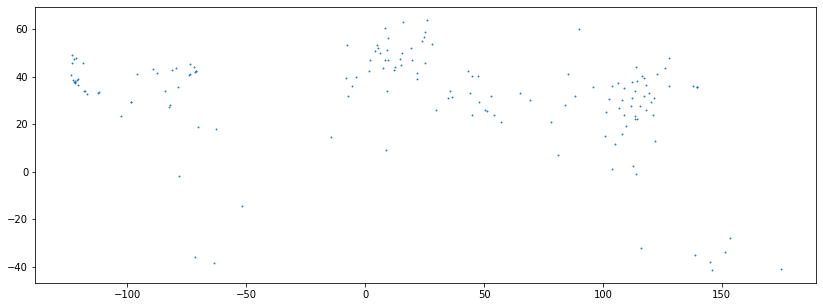

In [175]:
df_g.plot(marker='*', markersize=1, figsize = (14,7))

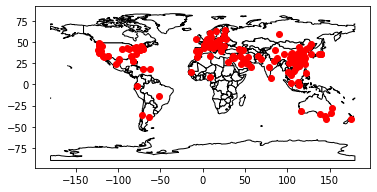

In [176]:
ax = world.plot(color='white', edgecolor='black')

df_g.plot(ax=ax, color='red')

plt.show()

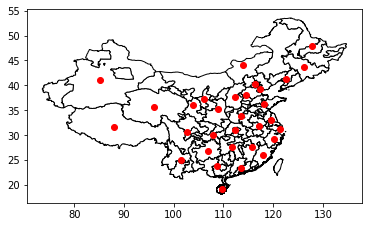

In [177]:
ax = china_2.plot(color='white', edgecolor='black')

df_g[df_g['country'] == 'China'].plot(ax=ax, color='red')

plt.show()

## Pointplot

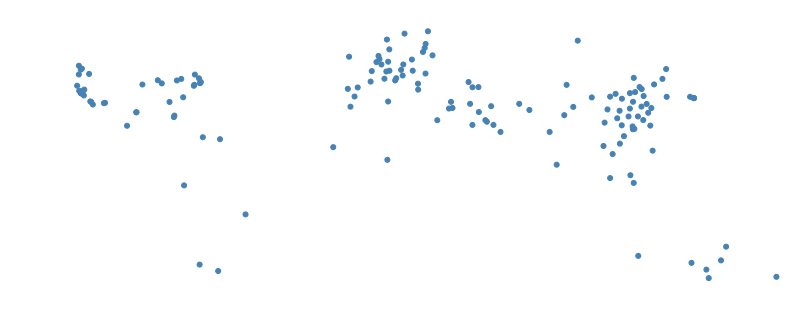

In [152]:
gplt.pointplot(df_g, figsize = (14,7))

## Polyplot and webmap with pointplot

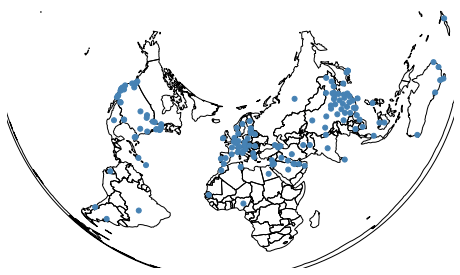

In [178]:
ax = gplt.polyplot(world, projection=gcrs.AlbersEqualArea())
gplt.pointplot(df_g, ax=ax)

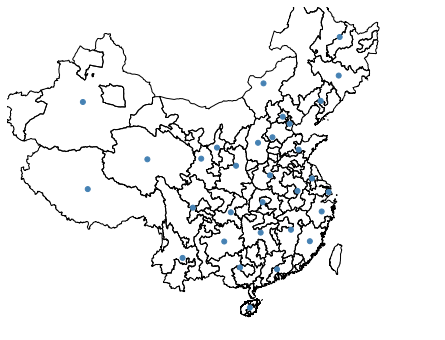

In [179]:
ax = gplt.polyplot(china_2, projection=gcrs.AlbersEqualArea())
gplt.pointplot(df_g[df_g['country'] == 'China'], ax=ax)

In [180]:
df_g.quantile(q = [0.2, 0.4, 0.6, 0.8, .99], axis=0)

,Lat,Long,latest_hosp_beds_per_1000,latest_doctors_per_1000,GDP_per_capita,SPAR_index,IVDI_score,city_pop,effective_dist,geo_dist,ann_pass_flux,connected_airports,12/08/19,12/09/19,12/10/19,12/11/19,12/12/19,12/13/19,12/14/19,12/15/19,12/16/19,12/17/19,12/18/19,12/19/19,12/20/19,12/21/19,12/22/19,12/23/19,12/24/19,12/25/19,12/26/19,12/27/19,12/28/19,12/29/19,12/30/19,12/31/19,01/01/20,01/02/20,01/03/20,01/04/20,01/05/20,01/06/20,01/07/20,01/08/20,01/09/20,1/10/20,01/11/20,01/12/20,01/13/20,01/14/20,01/15/20,01/16/20,01/17/20,01/18/20,01/19/20,01/20/20,01/21/20,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,2/25/20,2/26/20,2/27/20,2/28/20,2/29/20,3/1/20,3/2/20,3/3/20,3/4/20
0.20,23.80384,-78.729520,2.500,1.785500,18198.117742,67.353846,0.670439,1003.705157,6.571381,1897.175431,1.877242e+06,19.285714,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.0,0.00,0.00,0.00,0.00,0.00,0.0,0.00,0.00,0.00,0.00,0.0,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,1.00,1.00
0.40,32.98844,9.000000,2.900,2.266040,18725.445222,88.492308,0.676294,1267.967812,12.413289,6565.207869,3.171077e+06,30.327851,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.0,0.00,0.00,0.00,0.00,0.00,0.0,0.00,0.00,0.00,0.00,0.0,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,1.00,1.00,1.00,1.00,2.00,2.00,3.00
0.60,38.51602,51.910340,3.800,2.594800,48130.255973,91.000000,0.793626,1443.759862,13.235416,8553.334189,4.607010e+06,37.596923,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.00,0.00,0.00,0.00,0.00,0.00,1.00,1.00,1.00,1.00,1.00,1.0,1.00,1.00,1.00,1.00,1.00,1.0,1.00,1.00,1.00,1.00,1.0,1.00,1.00,1.00,1.00,2.00,2.00,2.00,2.00,2.00,2.00,3.00,4.00,6.00,7.40,9.00,11.40,15.00
0.80,44.29480,113.562800,4.200,3.252600,62794.585652,94.307692,0.819745,1800.035491,13.705051,10927.820869,6.597399e+06,51.658120,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,1.0,2.0,3.00,4.00,6.00,8.00,8.20,10.20,13.20,16.20,18.20,18.20,22.40,22.6,25.60,26.00,32.20,33.60,39.40,47.4,50.00,54.00,57.80,58.40,61.2,66.80,70.60,71.80,75.20,75.20,75.20,78.60,81.00,91.00,91.40,92.20,93.00,96.00,109.20,120.40,126.60,126.60
0.99,61.63488,152.217022,13.292,5.743312,118192.603627,99.709231,0.889388,7594.105001,15.987399,18380.947245,1.042922e+07,84.229012,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,19.52,29.3,47.6,69.36,107.22,138.58,188.64,285.74,388.04,482.92,564.44,645.34,724.46,820.36,895.0,961.36,1018.88,1069.62,1100.76,1122.82,1144.6,1173.64,1202.12,1219.42,1249.72,1270.1,1280.96,1289.66,1293.74,1295.82,1297.36,1301.74,1303.66,1305.04,1305.96,1305.96,1539.74,1802.94,2177.46,2633.32,3093.54,3736.64,4253.72


TypeError: can't multiply sequence by non-int of type 'float'

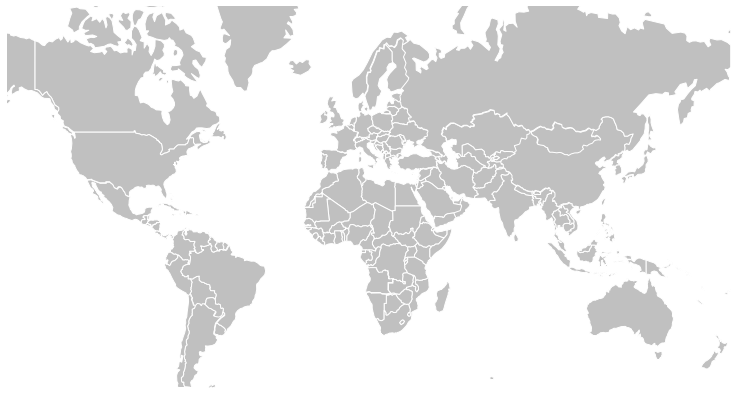

In [183]:
ax = gplt.polyplot(world, projection=gcrs.WebMercator(), edgecolor='white', facecolor='silver', 
                 figsize=(14, 7))
    
gplt.pointplot(df_g, ax=ax, hue='flux_cat', legend=True, 
               cmap = 'inferno_r', scheme='quantiles',
    scale='3/4/20', limits=(10, 25),
    legend_var='hue', legend_kwargs={'frameon': False},
    legend_labels=['Low passenger flux',
                                                 'Average passenger flux',
                                                 'High passenger flux'])

ax.set_title('Confirmed Coronavirus Cases by Air Network Connectivity', fontsize=16)

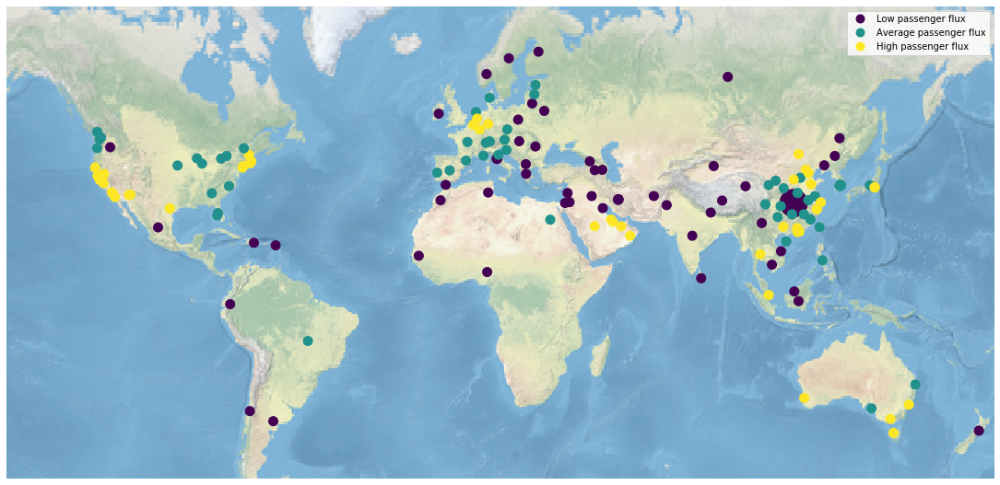

In [167]:
# ax = gplt.webmap(world, projection=gcrs.WebMercator())
scheme = mc.Quantiles(df_g['ann_pass_flux'], k=3)

fig = plt.figure(figsize=(19.2, 10.8))
ax = plt.axes(projection=ccrs.Mercator(central_longitude=0,  
                                       min_latitude=-65,
                                       max_latitude=70))
ax.background_img()
ax.set_extent([-170, 179, -65, 70], crs=ccrs.PlateCarree())

gplt.pointplot(df_g, scale = '3/4/20', limits = (10, 30), ax=ax, hue='ann_pass_flux', 
               legend=True, scheme=scheme, legend_labels= ['Low passenger flux',
                                                 'Average passenger flux',
                                                 'High passenger flux'], 
               legend_var = "hue")

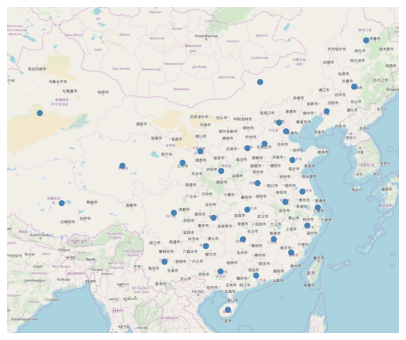

In [56]:
ax = gplt.webmap(china_2, projection=gcrs.WebMercator())
gplt.pointplot(df_g[df_g['country'] == 'China'], ax=ax)

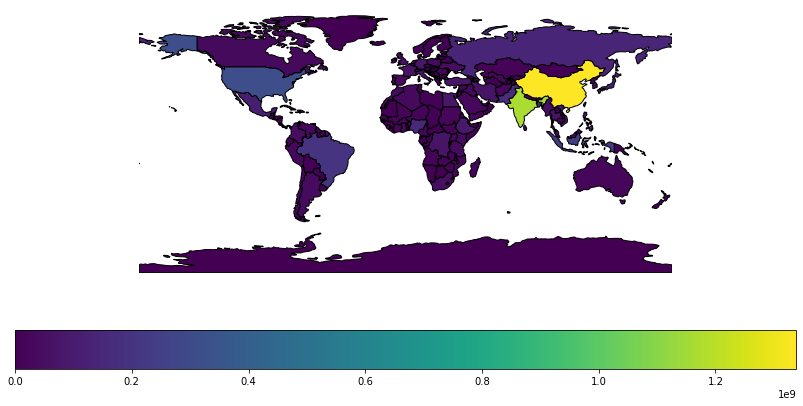

In [31]:
ax = gplt.choropleth(world, hue = 'pop_est',
                 legend=True, figsize=(14, 7), legend_kwargs={'orientation': 'horizontal'})


/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/geoplot/geoplot.py:685: UserWarning: Cound not set plot extent successfully due to numerical instability. Try setting extent manually. Defaulting to a global extent.
  'Cound not set plot extent successfully due to numerical instability. '


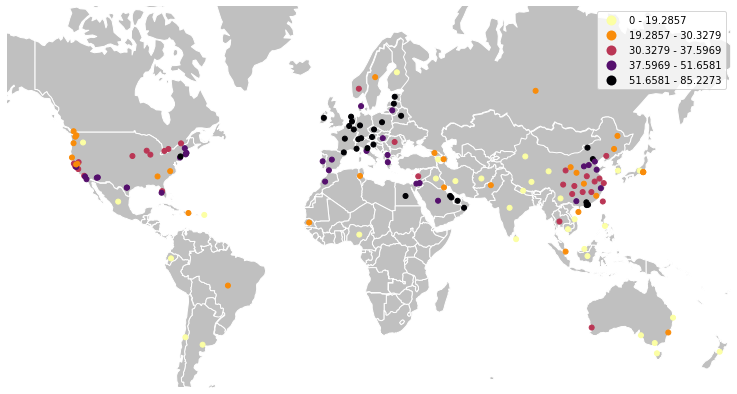

In [160]:
scheme = mc.Quantiles(df_g['connected_airports'], k=5)

ax = gplt.polyplot(world, projection=gcrs.WebMercator(), edgecolor='white', facecolor='silver', 
                 figsize=(14, 7))
    
gplt.pointplot(df_g, ax=ax, hue='connected_airports', legend=True, 
               cmap = 'inferno_r', scheme=scheme)

In [161]:
scheme

Quantiles             

   Interval      Count
----------------------
[ 3.00, 19.29] |    31
(19.29, 30.33] |    31
(30.33, 37.60] |    31
(37.60, 51.66] |    31
(51.66, 85.23] |    31

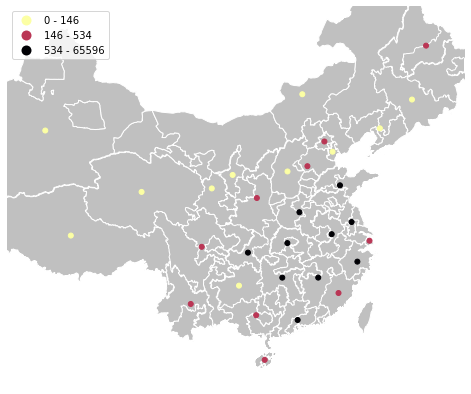

In [57]:
scheme = mc.Quantiles(df_g[df_g['country'] == 'China']['2/27/20'], k=3)

ax = gplt.polyplot(china_2, projection=gcrs.WebMercator(), edgecolor='white', facecolor='silver', 
                 figsize=(14, 7))
    
gplt.pointplot(df_g[df_g['country'] == 'China'], ax=ax, hue='2/27/20', legend=True, 
               cmap = 'inferno_r', scheme=scheme)

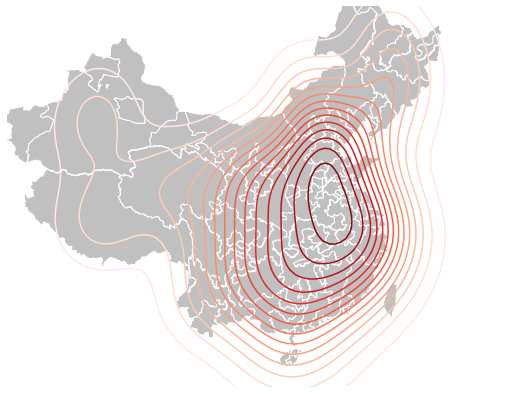

In [58]:
ax = gplt.polyplot(china_2, projection=gcrs.AlbersEqualArea(), edgecolor='white', facecolor='silver', 
                 figsize=(14, 7))

gplt.kdeplot(df_g[df_g['country'] == 'China'], ax=ax, projection=gcrs.AlbersEqualArea(), n_levels=20, cmap='Reds')

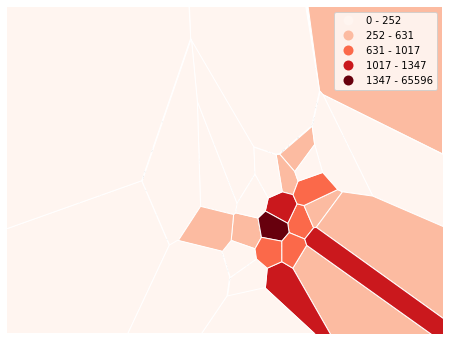

In [59]:
scheme = mc.NaturalBreaks(df_g[df_g['country'] == 'China']['2/27/20'], k=5)

ax = gplt.voronoi(df_g[df_g['country'] == 'China'], projection=gcrs.WebMercator(), hue='2/27/20', scheme=scheme, cmap='Reds',
                  legend=True, edgecolor='white', legend_kwargs={'loc': 'best'})
gplt.polyplot(china_2, ax=ax)

# Trying a gif for China!

In [60]:
len(df_g[df_g['country'] == 'China'])

31

In [190]:
prov_w_cases = gpd.sjoin(df_g[df_g['country'] == 'China'], china_2, how="right", op='intersects')
print(len(prov_w_cases))
prov_w_cases.head()

57


,index_left,Province/State,country,Lat,Long,latest_hosp_beds_per_1000,latest_doctors_per_1000,GDP_per_capita,SPAR_index,IVDI_score,city_pop,effective_dist,geo_dist,ann_pass_flux,connected_airports,12/08/19,12/09/19,12/10/19,12/11/19,12/12/19,12/13/19,12/14/19,12/15/19,12/16/19,12/17/19,12/18/19,12/19/19,12/20/19,12/21/19,12/22/19,12/23/19,12/24/19,12/25/19,12/26/19,12/27/19,12/28/19,12/29/19,12/30/19,12/31/19,01/01/20,01/02/20,01/03/20,01/04/20,01/05/20,01/06/20,01/07/20,01/08/20,01/09/20,1/10/20,01/11/20,01/12/20,01/13/20,01/14/20,01/15/20,01/16/20,01/17/20,01/18/20,01/19/20,01/20/20,01/21/20,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,2/25/20,2/26/20,2/27/20,2/28/20,2/29/20,3/1/20,3/2/20,3/3/20,3/4/20,flux_cat,ADM1_EN,ADM1_ZH,ADM1_PCODE,ADM0_EN,ADM0_ZH,ADM0_PCODE,geometry
index_right,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,76.0,Anhui,China,31.8257,117.2264,4.2,1.7855,18236.612982,94.307692,0.676294,1389.908204,5.802647,483.465190,4.596527e+06,35.288462,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,9.0,15.0,39.0,60.0,70.0,106.0,152.0,200.0,237.0,297.0,340.0,408.0,480.0,530.0,591.0,665.0,733.0,779.0,830.0,860.0,889.0,910.0,934.0,950.0,962.0,973.0,982.0,986.0,987.0,988.0,989.0,989.0,989.0,989.0,989.0,989.0,990.0,990.0,990.0,990.0,990.0,990.0,Low passenger flux,Anhui Province,å®å¾½ç,CN340,China,ä¸­å½,CN,"POLYGON ((116.935206535 34.08702338100009, 116..."
2,77.0,Beijing,China,40.1824,116.4142,4.2,1.7855,18236.612982,94.307692,0.676294,1928.254173,5.771801,1042.466853,7.961770e+06,53.272727,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,14.0,22.0,36.0,41.0,68.0,80.0,91.0,111.0,114.0,139.0,168.0,191.0,212.0,228.0,253.0,274.0,297.0,315.0,326.0,337.0,342.0,352.0,366.0,372.0,375.0,380.0,381.0,387.0,393.0,395.0,396.0,399.0,399.0,399.0,400.0,400.0,410.0,410.0,411.0,413.0,414.0,414.0,418.0,Average passenger flux,Beijing Municipality,åäº¬å¸,CN110,China,ä¸­å½,CN,"POLYGON ((117.3147077560001 40.18091513900004,..."
3,81.0,Chongqing,China,30.0572,107.8740,4.2,1.7855,18236.612982,94.307692,0.676294,1365.466727,5.696277,631.658695,4.739646e+06,34.346154,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,6.0,9.0,27.0,57.0,75.0,110.0,132.0,147.0,182.0,211.0,247.0,300.0,337.0,366.0,389.0,411.0,426.0,428.0,468.0,486.0,505.0,518.0,529.0,537.0,544.0,551.0,553.0,555.0,560.0,567.0,572.0,573.0,575.0,576.0,576.0,576.0,576.0,576.0,576.0,576.0,576.0,576.0,576.0,High passenger flux,Chongqing Municipality,éåºå¸,CN500,China,ä¸­å½,CN,"POLYGON ((109.5460034160001 31.72160671300003,..."
4,86.0,Fujian,China,26.0789,117.9874,4.2,1.7855,18236.612982,94.307692,0.676294,1487.790269,5.854983,726.428034,3.157411e+06,29.375000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,5.0,10.0,18.0,35.0,59.0,80.0,84.0,101.0,120.0,144.0,159.0,179.0,194.0,205.0,215.0,224.0,239.0,250.0,261.0,267.0,272.0,279.0,281.0,285.0,287.0,290.0,292.0,293.0,293.0,293.0,293.0,293.0,293.0,294.0,294.0,296.0,296.0,296.0,296.0,296.0,296.0,296.0,Low passenger flux,Fujian Province,ç¦å»ºç,CN350,China,ä¸­å½,CN,"(POLYGON ((117.232656503 23.63400016600008, 11..."
5,88.0,Gansu,China,36.0611,103.8343,4.2,1.7855,18236.612982,94.307692,0.676294,1143.578929,5.264009,1080.013453,4.461

In [193]:
prov_w_cases['3/4/20'].value_counts()

75.0       2
67332.0    1
1213.0     1
418.0      1
576.0      1
296.0      1
91.0       1
1350.0     1
252.0      1
146.0      1
168.0      1
318.0      1
480.0      1
1272.0     1
1018.0     1
631.0      1
935.0      1
93.0       1
125.0      1
18.0       1
245.0      1
758.0      1
338.0      1
133.0      1
538.0      1
136.0      1
1.0        1
76.0       1
174.0      1
990.0      1
Name: 3/4/20, dtype: int64

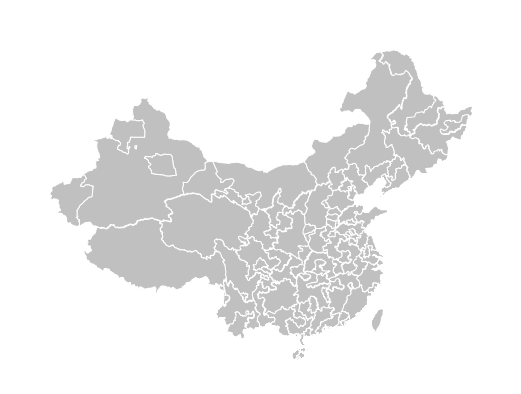

In [194]:
ax = gplt.polyplot(prov_w_cases, projection=gcrs.WebMercator(), edgecolor='white', 
                   facecolor='silver', figsize=(14, 7))

/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/matplotlib/colors.py:527: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


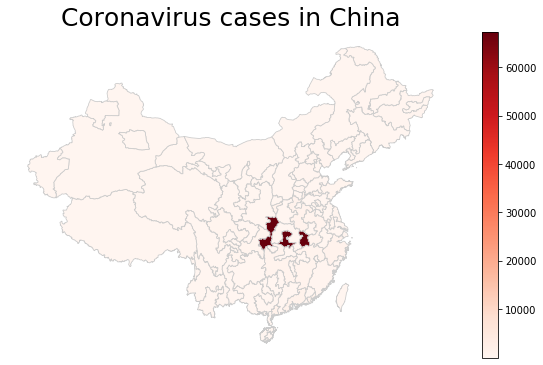

In [195]:
# starting with simple choropleth

# set a variable that will call whatever column we want to visualise on the map
variable = '3/4/20'

# set the range for the choropleth
# vmin, vmax = 0, 70000

# create figure and axes for Matplotlib
fig, ax = plt.subplots(1, figsize=(10, 6))

# create map
prov_w_cases.plot(column=variable, cmap='Reds', linewidth=0.8, ax=ax, edgecolor='0.8', legend=True)

# Now we can customise and add annotations

# remove the axis
ax.axis('off')

# add a title
ax.set_title('Coronavirus cases in China', \
              fontdict={'fontsize': '25',
                        'fontweight' : '3'})

# create an annotation for the  data source
# ax.annotate('Sources: China CDC, Johns Hopkins University',
#            xy=(0.1, .08), xycoords='figure fraction',
#            horizontalalignment='left', verticalalignment='top',
#            fontsize=10, color='#555555')

# Create colorbar as a legend
# sm = plt.cm.ScalarMappable(cmap='Reds', norm=plt.Normalize(vmin=vmin, vmax=vmax))
# sm._A = []
# cbar = fig.colorbar(sm)

# this will save the figure as a high-res png. you can also save as svg
fig.savefig('testmap.png', dpi=300)

In [196]:
prov_w_cases.head()

,index_left,Province/State,country,Lat,Long,latest_hosp_beds_per_1000,latest_doctors_per_1000,GDP_per_capita,SPAR_index,IVDI_score,city_pop,effective_dist,geo_dist,ann_pass_flux,connected_airports,12/08/19,12/09/19,12/10/19,12/11/19,12/12/19,12/13/19,12/14/19,12/15/19,12/16/19,12/17/19,12/18/19,12/19/19,12/20/19,12/21/19,12/22/19,12/23/19,12/24/19,12/25/19,12/26/19,12/27/19,12/28/19,12/29/19,12/30/19,12/31/19,01/01/20,01/02/20,01/03/20,01/04/20,01/05/20,01/06/20,01/07/20,01/08/20,01/09/20,1/10/20,01/11/20,01/12/20,01/13/20,01/14/20,01/15/20,01/16/20,01/17/20,01/18/20,01/19/20,01/20/20,01/21/20,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,2/25/20,2/26/20,2/27/20,2/28/20,2/29/20,3/1/20,3/2/20,3/3/20,3/4/20,flux_cat,ADM1_EN,ADM1_ZH,ADM1_PCODE,ADM0_EN,ADM0_ZH,ADM0_PCODE,geometry
index_right,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,76.0,Anhui,China,31.8257,117.2264,4.2,1.7855,18236.612982,94.307692,0.676294,1389.908204,5.802647,483.465190,4.596527e+06,35.288462,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,9.0,15.0,39.0,60.0,70.0,106.0,152.0,200.0,237.0,297.0,340.0,408.0,480.0,530.0,591.0,665.0,733.0,779.0,830.0,860.0,889.0,910.0,934.0,950.0,962.0,973.0,982.0,986.0,987.0,988.0,989.0,989.0,989.0,989.0,989.0,989.0,990.0,990.0,990.0,990.0,990.0,990.0,Low passenger flux,Anhui Province,å®å¾½ç,CN340,China,ä¸­å½,CN,"POLYGON ((116.935206535 34.08702338100009, 116..."
2,77.0,Beijing,China,40.1824,116.4142,4.2,1.7855,18236.612982,94.307692,0.676294,1928.254173,5.771801,1042.466853,7.961770e+06,53.272727,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,14.0,22.0,36.0,41.0,68.0,80.0,91.0,111.0,114.0,139.0,168.0,191.0,212.0,228.0,253.0,274.0,297.0,315.0,326.0,337.0,342.0,352.0,366.0,372.0,375.0,380.0,381.0,387.0,393.0,395.0,396.0,399.0,399.0,399.0,400.0,400.0,410.0,410.0,411.0,413.0,414.0,414.0,418.0,Average passenger flux,Beijing Municipality,åäº¬å¸,CN110,China,ä¸­å½,CN,"POLYGON ((117.3147077560001 40.18091513900004,..."
3,81.0,Chongqing,China,30.0572,107.8740,4.2,1.7855,18236.612982,94.307692,0.676294,1365.466727,5.696277,631.658695,4.739646e+06,34.346154,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,6.0,9.0,27.0,57.0,75.0,110.0,132.0,147.0,182.0,211.0,247.0,300.0,337.0,366.0,389.0,411.0,426.0,428.0,468.0,486.0,505.0,518.0,529.0,537.0,544.0,551.0,553.0,555.0,560.0,567.0,572.0,573.0,575.0,576.0,576.0,576.0,576.0,576.0,576.0,576.0,576.0,576.0,576.0,High passenger flux,Chongqing Municipality,éåºå¸,CN500,China,ä¸­å½,CN,"POLYGON ((109.5460034160001 31.72160671300003,..."
4,86.0,Fujian,China,26.0789,117.9874,4.2,1.7855,18236.612982,94.307692,0.676294,1487.790269,5.854983,726.428034,3.157411e+06,29.375000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,5.0,10.0,18.0,35.0,59.0,80.0,84.0,101.0,120.0,144.0,159.0,179.0,194.0,205.0,215.0,224.0,239.0,250.0,261.0,267.0,272.0,279.0,281.0,285.0,287.0,290.0,292.0,293.0,293.0,293.0,293.0,293.0,293.0,294.0,294.0,296.0,296.0,296.0,296.0,296.0,296.0,296.0,Low passenger flux,Fujian Province,ç¦å»ºç,CN350,China,ä¸­å½,CN,"(POLYGON ((117.232656503 23.63400016600008, 11..."
5,88.0,Gansu,China,36.0611,103.8343,4.2,1.7855,18236.612982,94.307692,0.676294,1143.578929,5.264009,1080.013453,4.461

In [189]:
prov_w_cases.columns.to_list()

['index_left',
 'Province/State',
 'city_county_state',
 'country',
 'Lat',
 'Long',
 'latest_hosp_beds_per_1000',
 'latest_doctors_per_1000',
 'GDP_per_capita',
 'SPAR_index',
 'IVDI_score',
 'city_pop',
 'effective_dist',
 'geo_dist',
 'ann_pass_flux',
 'connected_airports',
 '12/08/19',
 '12/09/19',
 '12/10/19',
 '12/11/19',
 '12/12/19',
 '12/13/19',
 '12/14/19',
 '12/15/19',
 '12/16/19',
 '12/17/19',
 '12/18/19',
 '12/19/19',
 '12/20/19',
 '12/21/19',
 '12/22/19',
 '12/23/19',
 '12/24/19',
 '12/25/19',
 '12/26/19',
 '12/27/19',
 '12/28/19',
 '12/29/19',
 '12/30/19',
 '12/31/19',
 '01/01/20',
 '01/02/20',
 '01/03/20',
 '01/04/20',
 '01/05/20',
 '01/06/20',
 '01/07/20',
 '01/08/20',
 '01/09/20',
 '1/10/20',
 '01/11/20',
 '01/12/20',
 '01/13/20',
 '01/14/20',
 '01/15/20',
 '01/16/20',
 '01/17/20',
 '01/18/20',
 '01/19/20',
 '01/20/20',
 '01/21/20',
 '1/22/20',
 '1/23/20',
 '1/24/20',
 '1/25/20',
 '1/26/20',
 '1/27/20',
 '1/28/20',
 '1/29/20',
 '1/30/20',
 '1/31/20',
 '2/1/20',
 '2/2/2

In [200]:
date_list = prov_w_cases.iloc[:, 15:-8].columns.to_list()

In [202]:
np.log(.01)

-4.605170185988091

In [206]:
prov_w_cases_2 = prov_w_cases.copy()

for date in date_list:
    for i in range(len(prov_w_cases_2)):
        if prov_w_cases_2[date][i] == 0.0:
            prov_w_cases_2[date][i] = np.log(.01)
        else:
            prov_w_cases_2[date][i] = np.log(prov_w_cases_2[date][i])

prov_w_cases_2.head() 

/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/ipykernel_launcher.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


,index_left,Province/State,country,Lat,Long,latest_hosp_beds_per_1000,latest_doctors_per_1000,GDP_per_capita,SPAR_index,IVDI_score,city_pop,effective_dist,geo_dist,ann_pass_flux,connected_airports,12/08/19,12/09/19,12/10/19,12/11/19,12/12/19,12/13/19,12/14/19,12/15/19,12/16/19,12/17/19,12/18/19,12/19/19,12/20/19,12/21/19,12/22/19,12/23/19,12/24/19,12/25/19,12/26/19,12/27/19,12/28/19,12/29/19,12/30/19,12/31/19,01/01/20,01/02/20,01/03/20,01/04/20,01/05/20,01/06/20,01/07/20,01/08/20,01/09/20,1/10/20,01/11/20,01/12/20,01/13/20,01/14/20,01/15/20,01/16/20,01/17/20,01/18/20,01/19/20,01/20/20,01/21/20,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,2/25/20,2/26/20,2/27/20,2/28/20,2/29/20,3/1/20,3/2/20,3/3/20,3/4/20,flux_cat,ADM1_EN,ADM1_ZH,ADM1_PCODE,ADM0_EN,ADM0_ZH,ADM0_PCODE,geometry
index_right,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,76.0,Anhui,China,31.8257,117.2264,4.2,1.7855,18236.612982,94.307692,0.676294,1389.908204,5.802647,483.465190,4.596527e+06,35.288462,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,0.0,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,0.000000,2.197225,2.708050,3.663562,4.094345,4.248495,4.663439,5.023881,5.298317,5.468060,5.693732,5.828946,6.011267,6.173786,6.272877,6.381816,6.499787,6.597146,6.658011,6.721426,6.756932,6.790097,6.813445,6.839476,6.856462,6.869014,6.880384,6.889591,6.893656,6.894670,6.895683,6.896694,6.896694,6.896694,6.896694,6.896694,6.896694,6.897705,6.897705,6.897705,6.897705,6.897705,6.897705,Low passenger flux,Anhui Province,å®å¾½ç,CN340,China,ä¸­å½,CN,"POLYGON ((116.935206535 34.08702338100009, 116..."
2,77.0,Beijing,China,40.1824,116.4142,4.2,1.7855,18236.612982,94.307692,0.676294,1928.254173,5.771801,1042.466853,7.961770e+06,53.272727,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,0.0,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,2.639057,3.091042,3.583519,3.713572,4.219508,4.382027,4.510860,4.709530,4.736198,4.934474,5.123964,5.252273,5.356586,5.429346,5.533389,5.613128,5.693732,5.752573,5.786897,5.820083,5.834811,5.863631,5.902633,5.918894,5.926926,5.940171,5.942799,5.958425,5.973810,5.978886,5.981414,5.988961,5.988961,5.988961,5.991465,5.991465,6.016157,6.016157,6.018593,6.023448,6.025866,6.025866,6.035481,Average passenger flux,Beijing Municipality,åäº¬å¸,CN110,China,ä¸­å½,CN,"POLYGON ((117.3147077560001 40.18091513900004,..."
3,81.0,Chongqing,China,30.0572,107.8740,4.2,1.7855,18236.612982,94.307692,0.676294,1365.466727,5.696277,631.658695,4.739646e+06,34.346154,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,0.0,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,-4.60517,1.791759,2.197225,3.295837,4.043051,4.317488,4.700480,4.882802,4.990433,5.204007,5.351858,5.509388,5.703782,5.820083,5.902633,5.963579,6.018593,6.054439,6.059123,6.148468,6.186209,6.224558,6.249975,6.270988,6.285998,6.298949,6.311735,6.315358,6

In [207]:
prov_w_cases_2['3/4/20'].max()

11.117390885538972

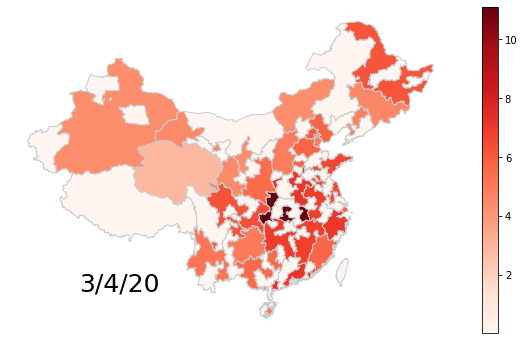

In [216]:
# starting with simple choropleth

# set a variable that will call whatever column we want to visualise on the map
variable = '3/4/20'

# set the range for the choropleth
vmin, vmax = np.log(.02), np.log(prov_w_cases_2['3/4/20'].max())

# create figure and axes for Matplotlib
fig, ax = plt.subplots(1, figsize=(10, 6))

# create map
prov_w_cases_2.plot(column=variable, cmap='Reds', linewidth=1, ax=ax, 
                  edgecolor='0.8')

# Now we can customise and add annotations

# remove the axis
ax.axis('off')

# add a title
# ax.set_title('Coronavirus cases in China', \
#               fontdict={'fontsize': '25',
#                         'fontweight' : '3'})

# create an annotation for the  data source
# ax.annotate('Sources: China CDC, Johns Hopkins University',
#            xy=(0.1, .08), xycoords='figure fraction',
#            horizontalalignment='left', verticalalignment='top',
#            fontsize=10, color='#555555')

ax.annotate(variable,
            xy=(0.15, .2), xycoords='figure fraction',
            horizontalalignment='left', verticalalignment='top',
            fontsize=25)

# Create colorbar as a legend
sm = plt.cm.ScalarMappable(cmap='Reds', norm=plt.Normalize(vmin=np.exp(vmin), vmax=np.exp(vmax)))
sm._A = []
cbar = fig.colorbar(sm)

# this will save the figure as a high-res png. you can also save as svg
fig.savefig('testmap.png', dpi=500)

In [91]:
# save all the maps in the charts folder
output_path = 'charts/maps'

# counter for the for loop
i = 0

# list of years (which are the column names at the moment)
list_of_dates = ['12/08/19', '12/09/19', '12/10/19', '12/11/19', '12/12/19', 
                        '12/13/19', '12/14/19', '12/15/19', '12/16/19', '12/17/19', '12/18/19', '12/19/19', 
                        '12/20/19', '12/21/19', '12/22/19', '12/23/19', '12/24/19', '12/25/19', '12/26/19', 
                        '12/27/19', '12/28/19', '12/29/19', '12/30/19', '12/31/19', '01/01/20', '01/02/20', 
                        '01/03/20', '01/04/20', '01/05/20', '01/06/20', '01/07/20', '01/08/20', '01/09/20',
                       '1/10/20', '01/11/20', '01/12/20', '01/13/20', '01/14/20', '01/15/20', '01/16/20', 
                        '01/17/20', '01/18/20', '01/19/20', '01/20/20', '01/21/20', '1/22/20', '1/23/20', 
                        '1/24/20', '1/25/20', '1/26/20', '1/27/20', '1/28/20', '1/29/20', '1/30/20', '1/31/20',
                       '2/1/20', '2/2/20', '2/3/20', '2/4/20', '2/5/20', '2/6/20', '2/7/20', '2/8/20', '2/9/20',
                       '2/10/20', '2/11/20', '2/12/20', '2/13/20', '2/14/20', '2/15/20', '2/16/20', '2/17/20', 
                        '2/18/20', '2/19/20', '2/20/20', '2/21/20', '2/22/20', '2/23/20', '2/24/20', '2/25/20', 
                        '2/26/20', '2/27/20']

In [107]:
# set the min and max range for the choropleth map
vmin, vmax = 1, 20

In [111]:
prov_w_cases['2/27/20'].mean()

2532.1935483870966

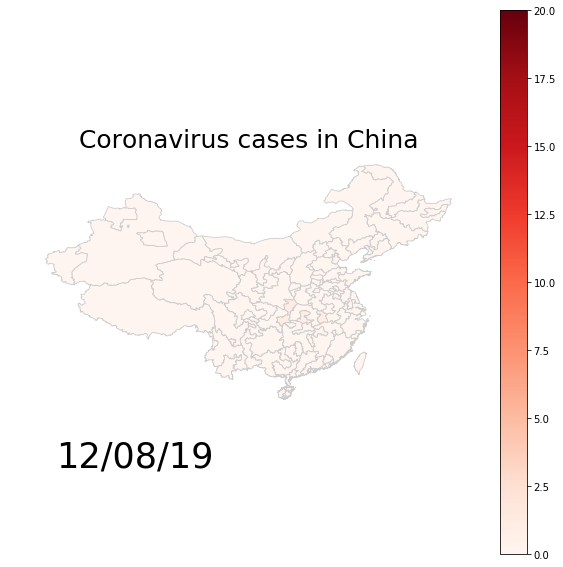

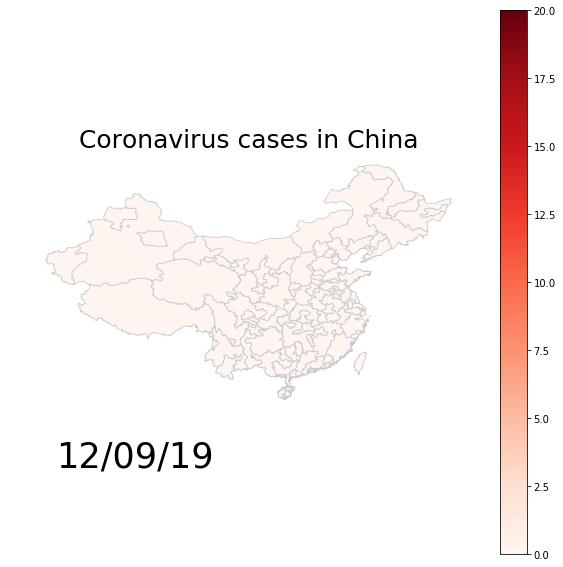

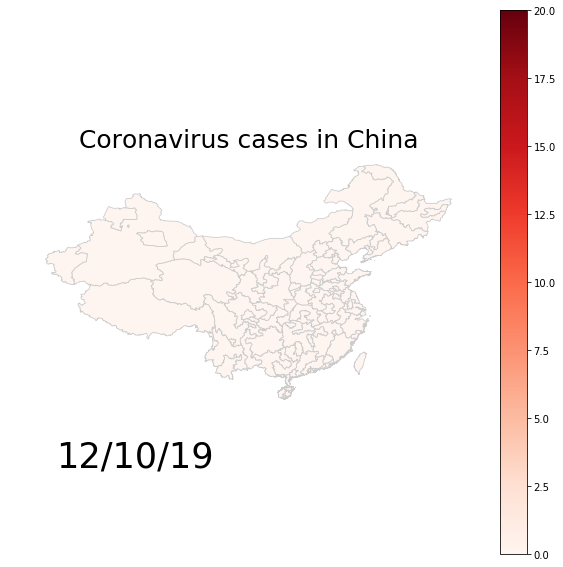

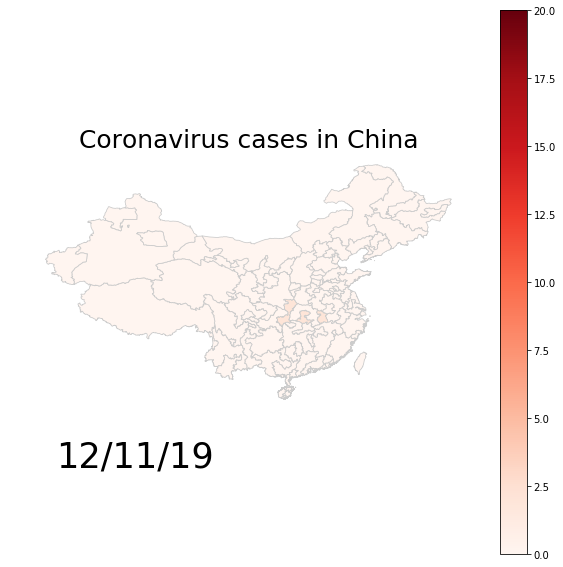

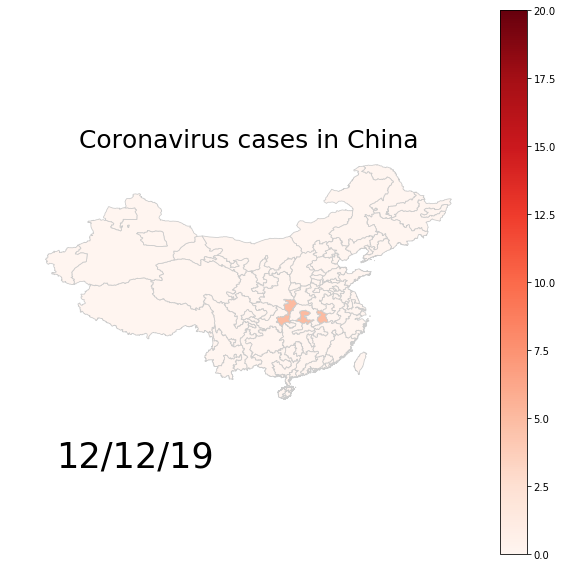

...

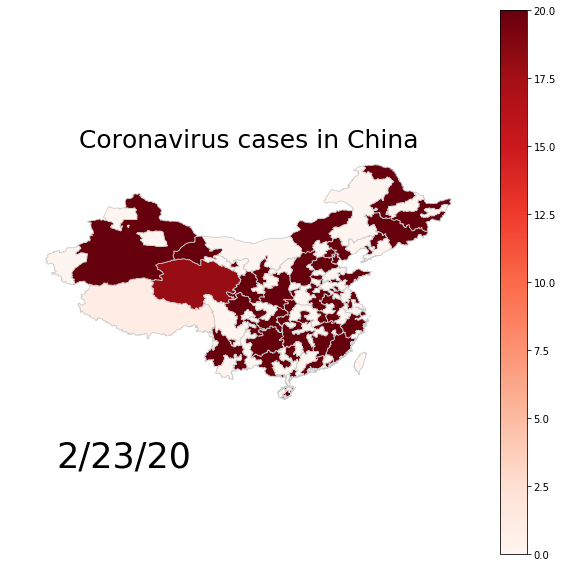

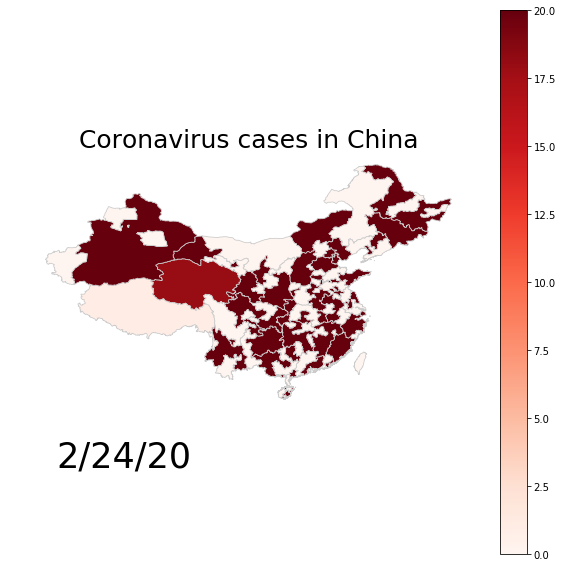

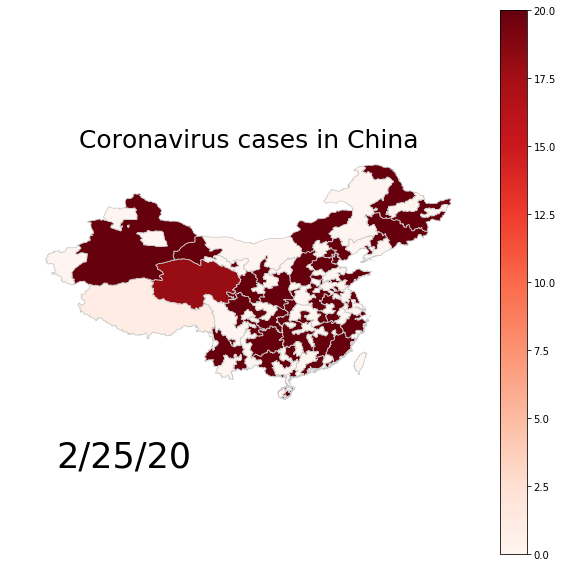

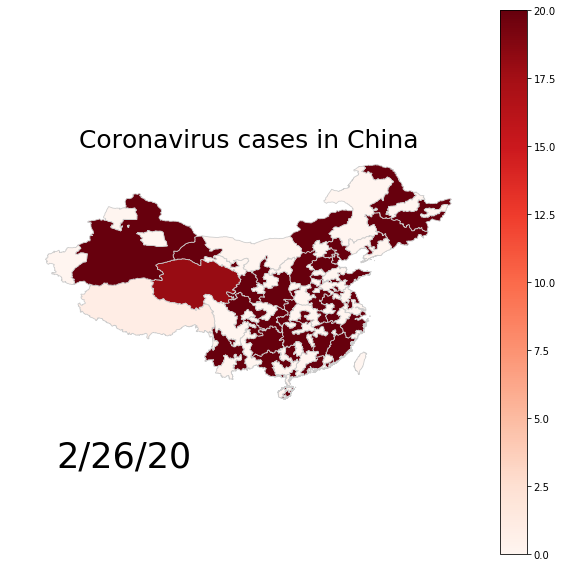

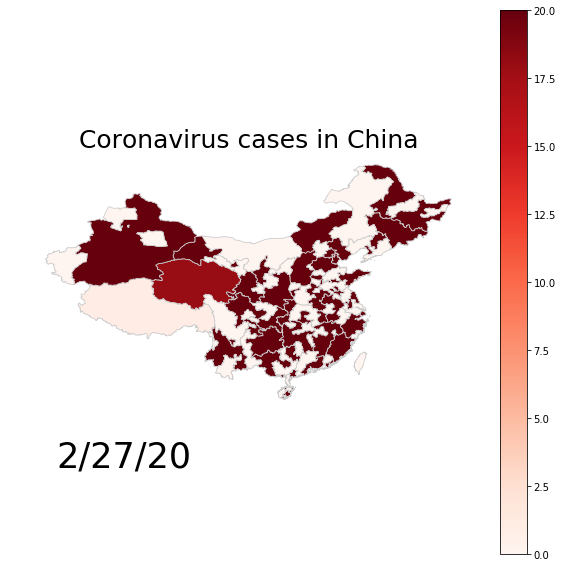

In [106]:
# start the for loop to create one map per date
for index, date in enumerate(list_of_dates):
    
    # create map, UDPATE: added plt.Normalize to keep the legend range the same for all maps
    fig = prov_w_cases.plot(column=date, cmap='Reds', figsize=(10,10), linewidth=0.8, edgecolor='0.8', vmin=vmin, vmax=vmax,
                            legend=True, norm=plt.Normalize(vmin=vmin, vmax=vmax))
    
    # remove axis of chart
    fig.axis('off')
    
    # add a title
    fig.set_title('Coronavirus cases in China', \
              fontdict={'fontsize': '25',
                         'fontweight' : '3'})
         # position the annotation to the bottom left
    fig.annotate(date,
            xy=(0.1, .225), xycoords='figure fraction',
            horizontalalignment='left', verticalalignment='top',
            fontsize=35)
    
    # this will save the figure as a high-res png in the output path. you can also save as svg if you prefer.
    filepath = os.path.join(output_path, str(index)+'_cases.jpg')
    chart = fig.get_figure()
    chart.savefig(filepath, dpi=500)

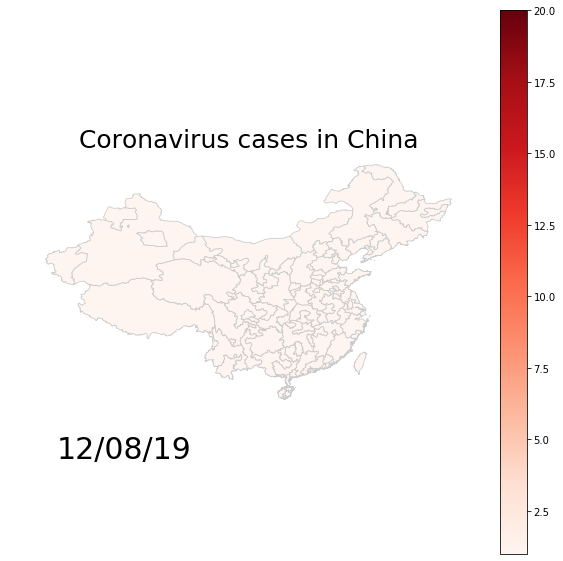

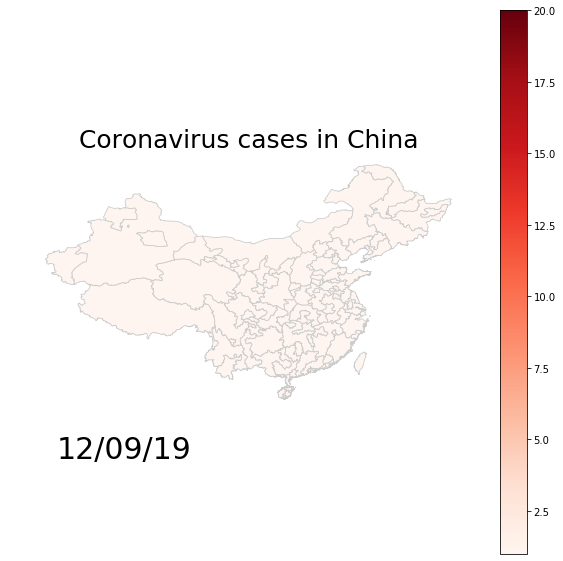

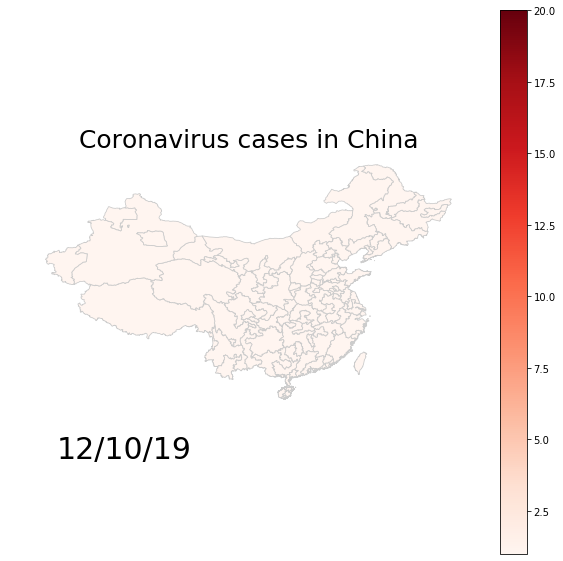

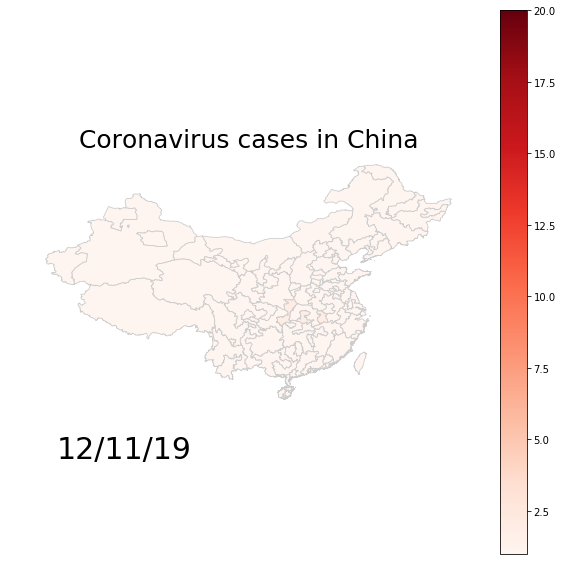

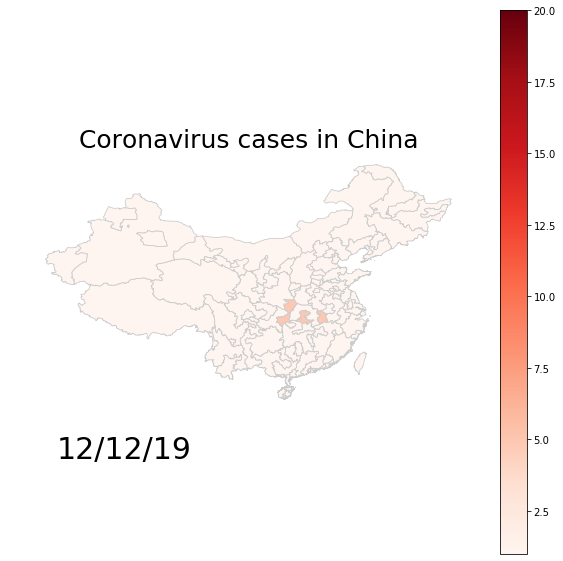

...

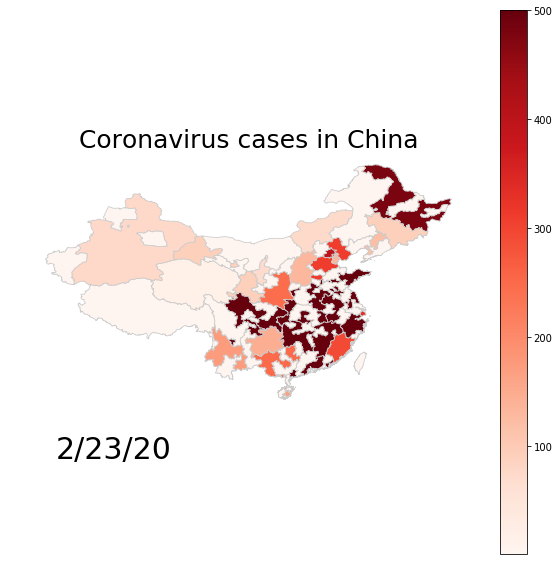

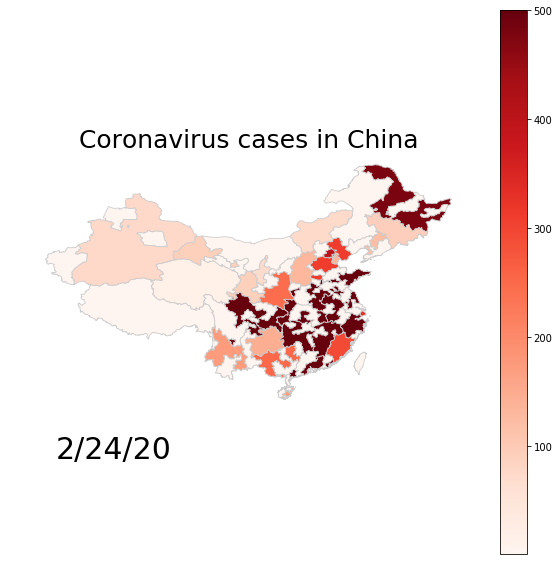

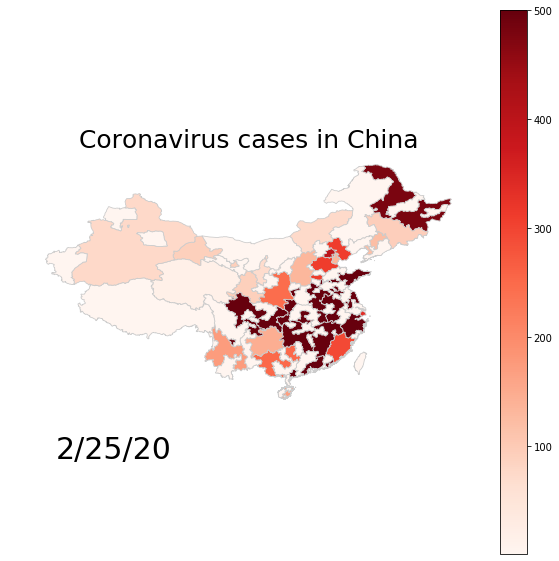

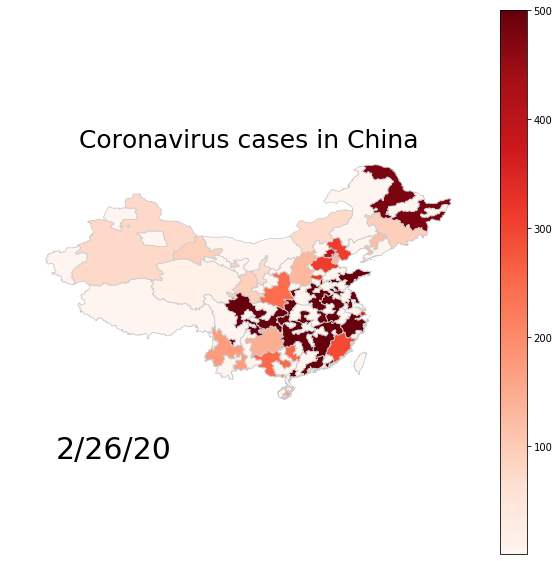

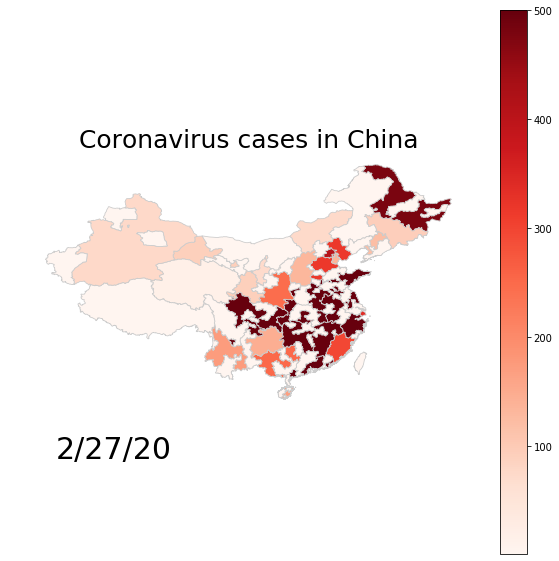

In [117]:
# start the for loop to create one map per date
for index, date in enumerate(list_of_dates):
    
    if prov_w_cases[date].mean() > 500:
        vmin, vmax = 1, 500
    elif prov_w_cases[date].mean() > 100:
        vmin, vmax = 1, 100
    else:
        vmin, vmax = 1, 20
    
    # create map, UDPATE: added plt.Normalize to keep the legend range the same for all maps
    fig = prov_w_cases.plot(column=date, cmap='Reds', figsize=(10,10), linewidth=0.8, edgecolor='0.8', vmin=vmin, vmax=vmax,
                            legend=True, norm=plt.Nobrmalize(vmin=vmin, vmax=vmax))
    
    # remove axis of chart
    fig.axis('off')
    
    # add a title
    fig.set_title('Coronavirus cases in China', \
              fontdict={'fontsize': '25',
                         'fontweight' : '3'})
         # position the annotation to the bottom left
    fig.annotate(date,
            xy=(0.1, .225), xycoords='figure fraction',
            horizontalalignment='left', verticalalignment='top',
            fontsize=30)
    
    # this will save the figure as a high-res png in the output path. you can also save as svg if you prefer.
    filepath = os.path.join(output_path, str(index)+'_cases.jpg')
    chart = fig.get_figure()
    chart.savefig(filepath, dpi=500)

In [168]:
prov_w_cases.head()

,index_left,Province/State,city_county_state,country,Lat,Long,latest_hosp_beds_per_1000,latest_doctors_per_1000,GDP_per_capita,SPAR_index,IVDI_score,city_pop,effective_dist,geo_dist,ann_pass_flux,connected_airports,12/08/19,12/09/19,12/10/19,12/11/19,12/12/19,12/13/19,12/14/19,12/15/19,12/16/19,12/17/19,12/18/19,12/19/19,12/20/19,12/21/19,12/22/19,12/23/19,12/24/19,12/25/19,12/26/19,12/27/19,12/28/19,12/29/19,12/30/19,12/31/19,01/01/20,01/02/20,01/03/20,01/04/20,01/05/20,01/06/20,01/07/20,01/08/20,01/09/20,1/10/20,01/11/20,01/12/20,01/13/20,01/14/20,01/15/20,01/16/20,01/17/20,01/18/20,01/19/20,01/20/20,01/21/20,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,2/25/20,2/26/20,2/27/20,ADM1_EN,ADM1_ZH,ADM1_PCODE,ADM0_EN,ADM0_ZH,ADM0_PCODE,geometry
index_right,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,44.0,Anhui,"Lianhua Community, 合肥政务文化新区, Anhui",China,31.8257,117.2264,4.2,1.7855,18236.612982,94.307692,0.676294,1389.908204,5.802647,483.465190,4.596527e+06,35.288462,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,9.0,15.0,39.0,60.0,70.0,106.0,152.0,200.0,237.0,297.0,340.0,408.0,480.0,530.0,591.0,665.0,733.0,779.0,830.0,860.0,889.0,910.0,934.0,950.0,962.0,973.0,982.0,986.0,987.0,988.0,989.0,989.0,989.0,989.0,989.0,989.0,Anhui Province,å®å¾½ç,CN340,China,ä¸­å½,CN,"POLYGON ((116.935206535 34.08702338100009, 116..."
2,45.0,Beijing,", Changping District, Beijing",China,40.1824,116.4142,4.2,1.7855,18236.612982,94.307692,0.676294,1928.254173,5.771801,1042.466853,7.961770e+06,53.272727,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,14.0,22.0,36.0,41.0,68.0,80.0,91.0,111.0,114.0,139.0,168.0,191.0,212.0,228.0,253.0,274.0,297.0,315.0,326.0,337.0,342.0,352.0,366.0,372.0,375.0,380.0,381.0,387.0,393.0,395.0,396.0,399.0,399.0,399.0,400.0,400.0,410.0,Beijing Municipality,åäº¬å¸,CN110,China,ä¸­å½,CN,"POLYGON ((117.3147077560001 40.18091513900004,..."
3,49.0,Chongqing,", Fengdu County, Chongqing",China,30.0572,107.8740,4.2,1.7855,18236.612982,94.307692,0.676294,1365.466727,5.696277,631.658695,4.739646e+06,34.346154,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,6.0,9.0,27.0,57.0,75.0,110.0,132.0,147.0,182.0,211.0,247.0,300.0,337.0,366.0,389.0,411.0,426.0,428.0,468.0,486.0,505.0,518.0,529.0,537.0,544.0,551.0,553.0,555.0,560.0,567.0,572.0,573.0,575.0,576.0,576.0,576.0,576.0,Chongqing Municipality,éåºå¸,CN500,China,ä¸­å½,CN,"POLYGON ((109.5460034160001 31.72160671300003,..."
4,52.0,Fujian,"Sanming City, Youxi County, Fujian",China,26.0789,117.9874,4.2,1.7855,18236.612982,94.307692,0.676294,1487.790269,5.854983,726.428034,3.157411e+06,29.375000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,5.0,10.0,18.0,35.0,59.0,80.0,84.0,101.0,120.0,144.0,159.0,179.0,194.0,205.0,215.0,224.0,239.0,250.0,261.0,267.0,272.0,279.0,281.0,285.0,287.0,290.0,292.0,293.0,293.0,293.0,293.0,293.0,293.0,294.0,294.0,296.0,Fujian Province,ç¦å»ºç,CN350,China,ä¸­å½,CN,"(POLYGON ((117.232656503 23.63400016600008, 11..."
5,53.0,Gansu,"Guangwumen Subdistrict, Chengguan District, Gansu",China,36.0611,103.8343,4.2,1.7855,18236.612982,94.307692,0.676294,1143.578929,5.264009,1080.013453,4.461602e+06,32.666667,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0

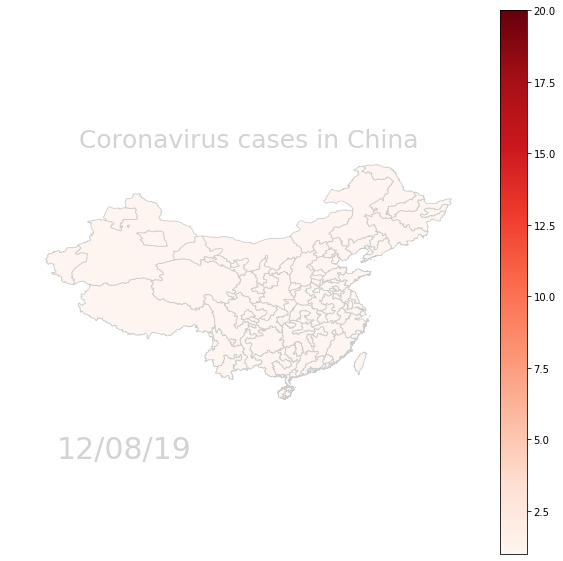

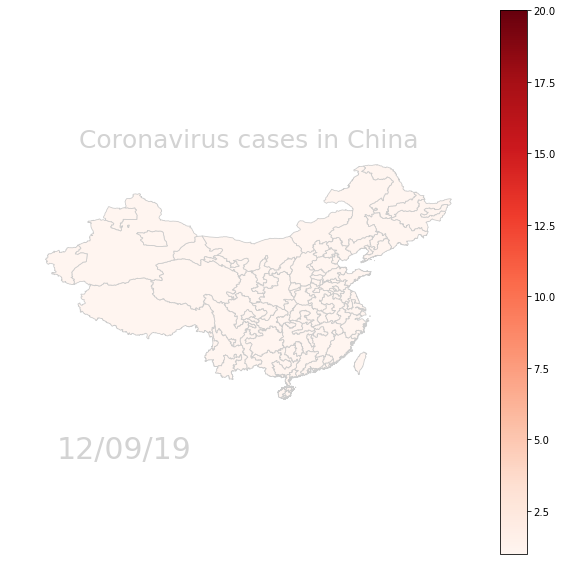

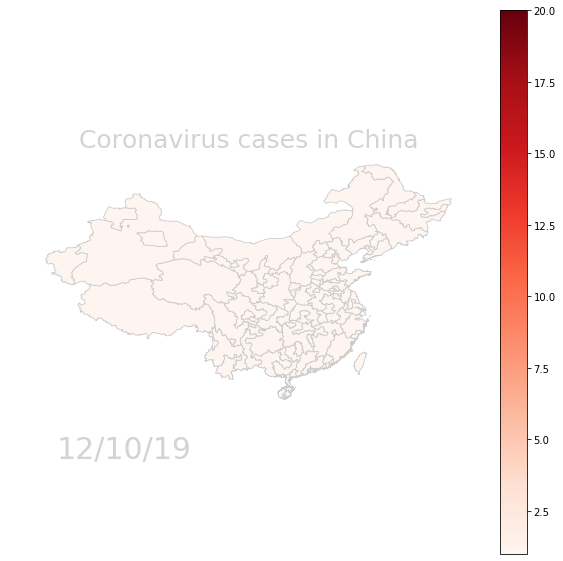

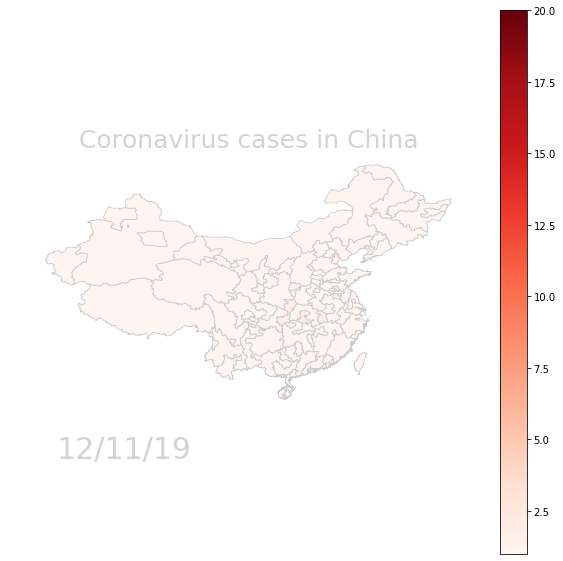

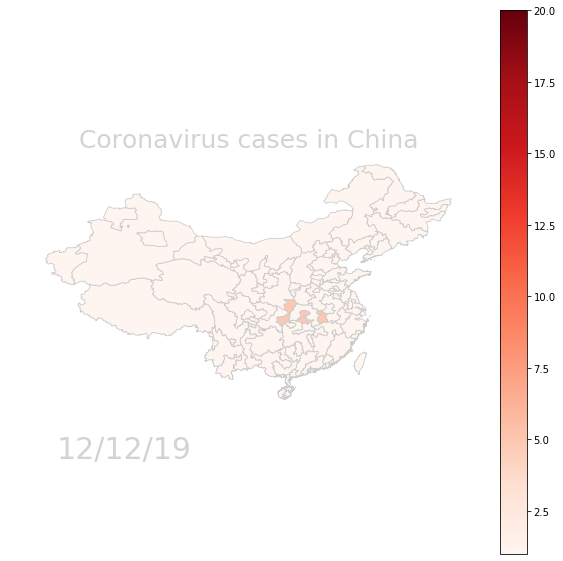

...

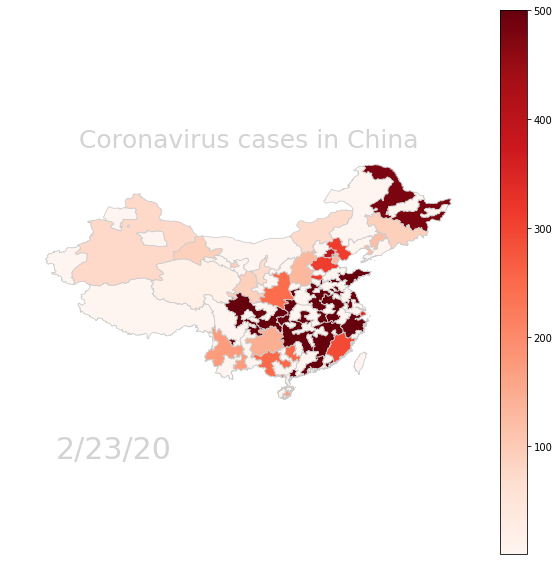

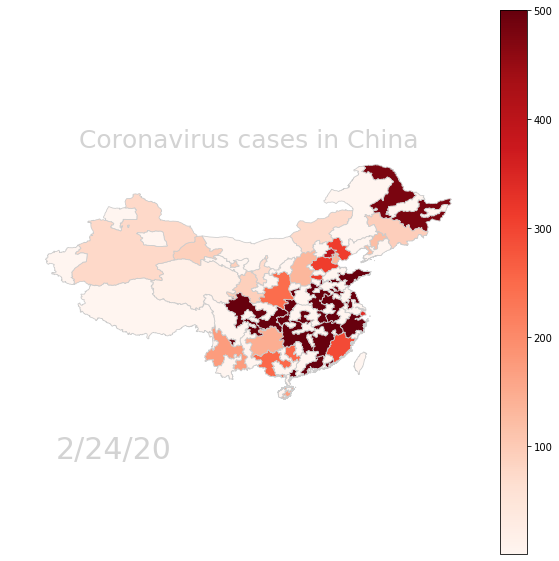

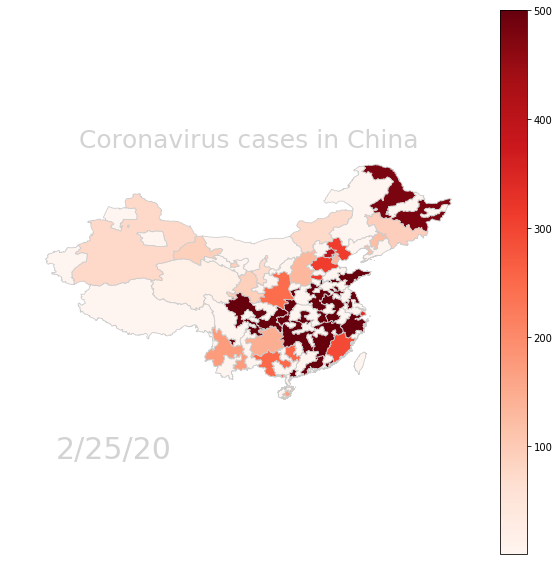

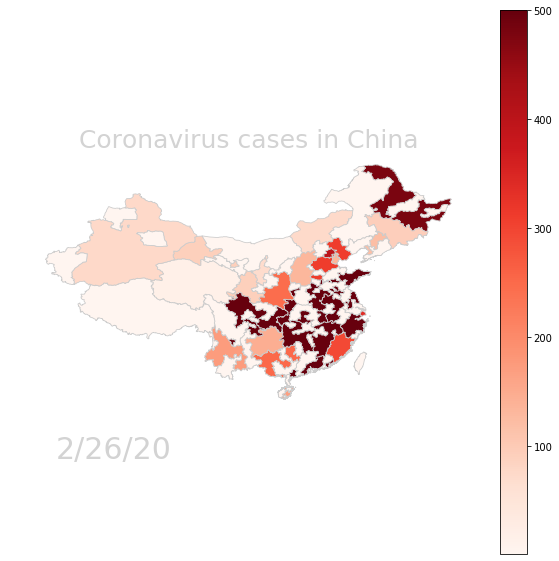

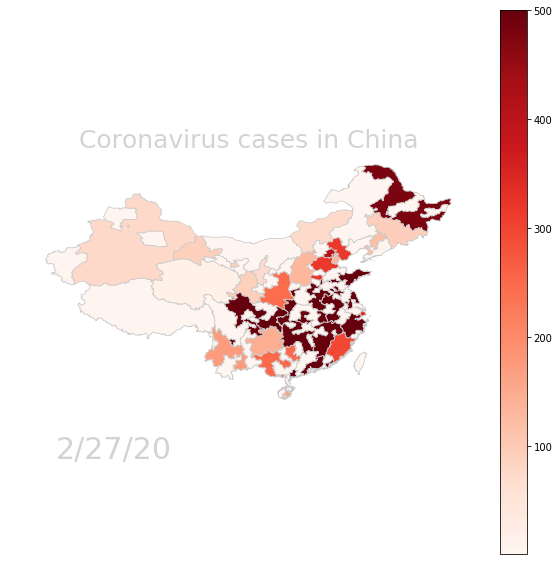

In [143]:
# start the for loop to create one map per date
for index, date in enumerate(list_of_dates):
    
    if prov_w_cases[date].mean() > 500:
        vmin, vmax = 1, 500
    elif prov_w_cases[date].mean() > 100:
        vmin, vmax = 1, 100
    else:
        vmin, vmax = 1, 20
    
    # create map, UDPATE: added plt.Normalize to keep the legend range the same for all maps
    fig = prov_w_cases.plot(column=date, cmap='Reds', figsize=(10,10), linewidth=0.8, edgecolor='0.8', vmin=vmin, vmax=vmax,
                            legend=True, norm=plt.Normalize(vmin=vmin, vmax=vmax))
    
    # remove axis of chart
    fig.axis('off')
    
    # add a title
    fig.set_title('Coronavirus cases in China', \
              fontdict={'fontsize': '25',
                         'fontweight' : '3'}, color='lightgray')
         # position the annotation to the bottom left
    fig.annotate(date,
            xy=(0.1, .225), xycoords='figure fraction',
            horizontalalignment='left', verticalalignment='top',
            fontsize=30, color = 'lightgray')
    
    # this will save the figure as a high-res png in the output path. you can also save as svg if you prefer.
    filepath = os.path.join(output_path, 'f_'+str(index)+'_cases.jpg')
    chart = fig.get_figure()
    chart.savefig(filepath, dpi=500)

# Using Cartopy to map cases around the world

Source: https://medium.com/udacity/creating-map-animations-with-python-97e24040f17b

In [122]:
ts = pd.read_csv('time_series_cases.csv', index_col = 0)
ts['date'] = pd.to_datetime(ts['date'])
ts.head()

,Province/State,city_county_state,country,hospital beds,physicians,GDP_per_capita,SPAR_index,IVDI_score,city_pop,effective_dist,geo_dist,ann_pass_flux,connected_airports,date,confirmed_cases
0,0,", ,",San Marino,3.8,6.1468,13536.794829,32.846154,0.696439,811.059130,12.909125,8530.463669,3.312232e+06,54.719512,2020-01-10,0.0
1,0,", , Abu Dhabi",United Arab Emirates,1.2,2.3944,75075.257411,94.615385,0.718802,1210.169908,12.417796,5798.434510,9.665304e+06,70.277778,2020-01-10,0.0
2,0,", , Al Wusta",Oman,1.6,1.9697,41859.934477,100.000000,0.617149,1085.491700,11.108324,5690.297304,8.373158e+06,72.250000,2020-01-10,0.0
3,0,", , Jahra",Kuwait,2.0,2.5789,72897.562345,55.615385,0.668414,1290.116059,13.896034,6180.024430,2.496246e+06,28.187500,2020-01-10,0.0
4,0,", , Lopburi Province",Thailand,2.1,0.8096,19051.333382,79.461538,0.687330,1862.299400,7.352859,2074.761769,6.238800e+06,32.937500,2020-01-10,0.0


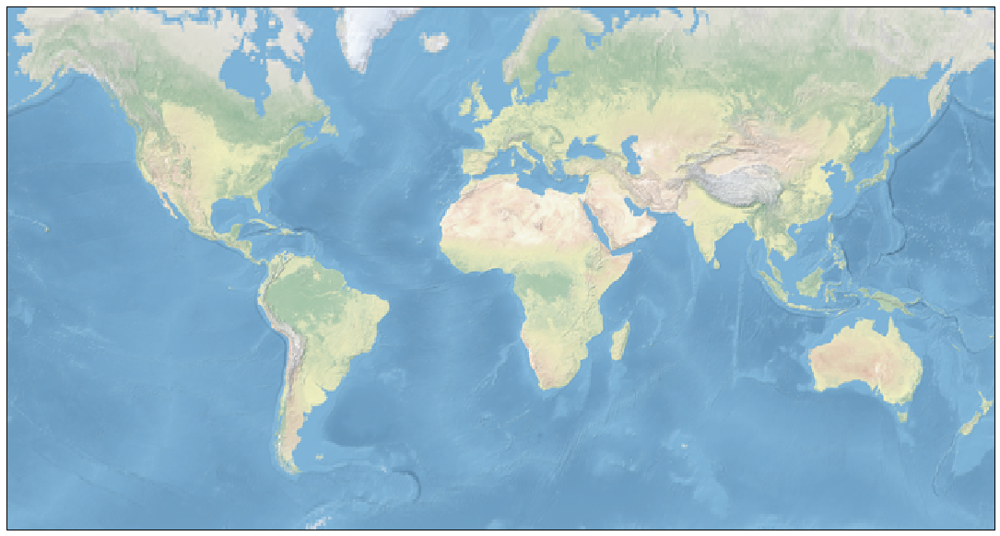

In [138]:
fig = plt.figure(figsize=(19.2, 10.8))
ax = plt.axes(projection=ccrs.Mercator(central_longitude=0,  
                                       min_latitude=-65,
                                       max_latitude=70))
ax.background_img()
ax.set_extent([-170, 179, -65, 70], crs=ccrs.PlateCarree())

In [139]:
# Define colors for annual passenger flux

colors = {'Low passenger flux': '#02b3e4',
          'Average passenger flux': '#f95c3c' ,
          'High passenger flux': '#ff5483'}

ts['flux_cat'] = pd.qcut(x = ts['ann_pass_flux'], q = 3, labels = ['Low passenger flux',
                                                 'Average passenger flux',
                                                 'High passenger flux'])

In [140]:
ts.flux_cat.value_counts()

Average passenger flux    2835
Low passenger flux        2835
High passenger flux       2754
Name: flux_cat, dtype: int64

In [141]:
for location, data in ts.groupby('Province/State', 'city_county_state', 'country'):
    
    case_counts = data.groupby(['Long', 'Lat']).count()
    
    # Get lists for longitudes and latitudes of graduates
    index = list(case_counts.index)
    longs = [each[0] for each in index]
    lats = [each[1] for each in index]
    sizes = case_counts['Province/State', 'city_county_state', 'country']*10
    # The school names are like 'School of AI', remove 'School of '
    flux = location['flux_cat']
    
    ax.scatter(longs, lats, s=sizes,
               color=colors[flux], alpha=0.8,
               transform=ccrs.PlateCarree())

ValueError: No axis named city_county_state for object type <class 'pandas.core.frame.DataFrame'>

In [ ]:
fontname = 'Open Sans'
fontsize = 28
# Positions for the date and grad counter
date_x = -53
date_y = -50
date_spacing = 65
# Positions for the school labels
name_x = -70
name_y = -60      
name_spacing = {'Developers': 0,
                'AI': 55,
                'Business': 1.9*55,
                'Aut Sys': 3*55}
# Date text
ax.text(date_x, date_y, 
        f"{date.strftime('%b %d, %Y')}", 
        color='white',
        fontname=fontname, fontsize=fontsize*1.3,
        transform=ccrs.PlateCarree())
# Total grad counts
ax.text(date_x + date_spacing, date_y, 
        "GRADUATES", color='white',
        fontname=fontname, fontsize=fontsize,
        transform=ccrs.PlateCarree())
ax.text(date_x + date_spacing*1.7, date_y, 
        f"{grads.groupby(['Long', 'Lat']).count()['School'].sum()}",
        color='white', ha='left',
        fontname=fontname, fontsize=fontsize*1.3,
        transform=ccrs.PlateCarree())
for school_name in ['Developers', 'AI', 'Business', 'Aut Sys']:
    ax.text(name_x + name_spacing[school_name], 
            name_y, 
            school_name.upper(), ha='center',
            fontname=fontname, fontsize=fontsize*1.1,
            color=colors[school_name],
            transform=ccrs.PlateCarree())
# Expands image to fill the figure and cut off margins
fig.tight_layout(pad=-0.5)

In [ ]:
def make_grads_map(date, data, ax=None, resolution='low'):
    
    if ax is None:
        fig = plt.figure(figsize=(19.2, 10.8))
        ax = plt.axes(projection=ccrs.Mercator(min_latitude=-65,
                                               max_latitude=70))
    
    ax.background_img(name='BM', resolution=resolution)
    ax.set_extent([-170, 179, -65, 70], crs=ccrs.PlateCarree())
    grads = data[data['Grad Date'] < date] 
    
    ### rest of the code
start_date = datetime(2017, 1, 1)
end_date = datetime(2018, 3, 15)
fig = plt.figure(figsize=(19.2, 10.8))
ax = plt.axes(projection=ccrs.Mercator(min_latitude=-65,
                                       max_latitude=70))
# Generate an image for each day between start_date and end_date
for ii, days in enumerate(range((end_date - start_date).days)):
    date = start_date + timedelta(days)
    ax = make_grads_map(date, df, ax=ax, resolution='full')
    fig.tight_layout(pad=-0.5)
    fig.savefig(f"frames/frame_{ii:04d}.png", dpi=100,     
                frameon=False, facecolor='black')
    ax.clear()

In [ ]:
# in terminal:
# ffmpeg -framerate 21 -i frames/frame_%4d.png -c:v h264 -r 30 -s 1920x1080 ./grads.mp4